# Airbnb locations

So, I want to go on vacations and I want to book my self-catering property on Airbnb. But I don't know where to go. So I will compare few datasets about different cities on Airbnb.

In [50]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image

import folium

import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.subplots import make_subplots

import plotly.express as px

from Tkinter import *

ModuleNotFoundError: No module named 'Tkinter'

# Data cleaning

I will compare the city of **New York** in the USA and **Buenos Aires** in Argentina.  

The dataset is composed of 16 columns in both dataset : 
* id
* name
* host_id
* host_name
* neighbourhood_group
* neighbourhood
* latitude
* longitude
* room_type
* price
* minimum_nights
* number_of_reviews
* last_review
* reviews_per_month
* calculated_host_listings_count
* availability_365

In [2]:
ny_airbnb = pd.read_csv('./new-york-city-airbnb-open-data/AB_NYC_2019.csv')
ba_airbnb = pd.read_csv('Buenos_Aires_AIRBNB.csv')

In [3]:
ny_airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [4]:
ba_airbnb.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,7270,¡¡Great Loft in Palermo Hollywood!!,18822,Toni,Palermo,-34.58241,-58.43382,Entire home/apt,2033,20,14,30-04-2018,0.15,1,363
1,11508,Amazing Luxurious Apt-Palermo Soho,42762,Candela,Palermo,-34.58225,-58.42460,Entire home/apt,3588,2,25,13-08-2019,0.28,1,281
2,12463,Room in Recoleta - awesome location,48799,Matt,Recoleta,-34.59761,-58.39468,Private room,1435,1,20,11-12-2017,0.17,1,365
3,13095,Standard Room at Palermo Viejo B&B,50994,Ariel,Palermo,-34.59382,-58.42994,Private room,2691,1,1,18-12-2018,0.09,7,360
4,13096,Standard Room in Palermo Viejo B&B,50994,Ariel,Palermo,-34.59398,-58.42853,Private room,2691,1,0,NaN,NaN,7,360


So, as we can see we have the price for each data sets in the money of the country.   
In order to make sense to these values, we are going to convert the price colum into **Euros**.

We use google to convert prices.

In [5]:
ny_airbnb['price'] /= 1.08 
ba_airbnb['price'] /= 66.69

Now we want to add another column to range **prices**. We will range them in categorize 50 by 50€ when it's bigger than 100€.

In [6]:
def categorize_price(df):
    labels = ['1. Between 0 and 25€', 
          '2. Between 25 and 50€', 
          '3. Between 50 and 100€',
          '4. Between 100 and 150€', 
          '5. Between 150 and 200€', 
          '6. Between 200 and 250€',
          '7. Between 250 and 300€', 
          '8. Between 300 and 500€',
          '9. Between 500 and '+ str(int(max(df['price']))) + '€']
    bins=[0,25,50,100,150,200,250,300,500, max(df['price'])]
    
    price_cat = pd.cut(df['price'], bins=bins, include_lowest=True, labels=labels)
    return pd.concat([df, price_cat], axis=1)

In [7]:
ba_airbnb=categorize_price(ba_airbnb)
ny_airbnb=categorize_price(ny_airbnb)
ny_airbnb.columns = ['id', 'name', 'host_id', 
                  'host_name', 'neighbourhood_group','neighbourhood',
                  'latitude', 'longitude', 'room_type',
                  'price','minimum_nights', 'number_of_reviews',
                  'last_review','reviews_per_month', 'calculated_host_listings_count',
                  'availability_365', 'price_cat']

ba_airbnb.columns = ['id', 'name', 'host_id', 
                  'host_name','neighbourhood',
                  'latitude', 'longitude', 'room_type',
                  'price','minimum_nights', 'number_of_reviews',
                  'last_review','reviews_per_month', 'calculated_host_listings_count',
                  'availability_365', 'price_cat']

ny_airbnb.sort_values(['price_cat'], ascending=True)
ba_airbnb.sort_values(['price_cat'], ascending=True);

In [8]:
ny_airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_cat
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,137.962963,1,9,2018-10-19,0.21,6,365,4. Between 100 and 150€
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,208.333333,1,45,2019-05-21,0.38,2,355,6. Between 200 and 250€
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,138.888889,3,0,NaN,NaN,1,365,4. Between 100 and 150€
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,82.407407,1,270,2019-07-05,4.64,1,194,3. Between 50 and 100€
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,74.074074,10,9,2018-11-19,0.10,1,0,3. Between 50 and 100€


In [9]:
ba_airbnb.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,price_cat
0,7270,¡¡Great Loft in Palermo Hollywood!!,18822,Toni,Palermo,-34.58241,-58.43382,Entire home/apt,30.484330,20,14,30-04-2018,0.15,1,363,2. Between 25 and 50€
1,11508,Amazing Luxurious Apt-Palermo Soho,42762,Candela,Palermo,-34.58225,-58.42460,Entire home/apt,53.801170,2,25,13-08-2019,0.28,1,281,3. Between 50 and 100€
2,12463,Room in Recoleta - awesome location,48799,Matt,Recoleta,-34.59761,-58.39468,Private room,21.517469,1,20,11-12-2017,0.17,1,365,1. Between 0 and 25€
3,13095,Standard Room at Palermo Viejo B&B,50994,Ariel,Palermo,-34.59382,-58.42994,Private room,40.350877,1,1,18-12-2018,0.09,7,360,2. Between 25 and 50€
4,13096,Standard Room in Palermo Viejo B&B,50994,Ariel,Palermo,-34.59398,-58.42853,Private room,40.350877,1,0,NaN,NaN,7,360,2. Between 25 and 50€


# Data Analysis

Now, we'll start our analysis.

First, we compare the size of the two datasets and we can visualise just the mean price and the median price. 

In [10]:
print('Number of values in NY:', ny_airbnb['id'].count())
print('Number of values in BA:', ba_airbnb['id'].count())

print('\nMean price in Buenos Aires :',round(ba_airbnb['price'].mean()), '€\nMean price in New York :',round(ny_airbnb['price'].mean()),'€')

print('\nMedian price in Buenos Aires :',round(ba_airbnb['price'].median()), '€\nMedian price in New York :',round(ny_airbnb['price'].median()),'€')
    

Number of values in NY: 48895
Number of values in BA: 22877

Mean price in Buenos Aires : 48 €
Mean price in New York : 141 €

Median price in Buenos Aires : 30 €
Median price in New York : 98 €


Now, we will look at the repartition of Airbnbs in the two cities.

In [11]:
from folium.plugins import HeatMap
m=folium.Map([40.7128,-74.0060],zoom_start=10)
HeatMap(ny_airbnb[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(m)
display(m)

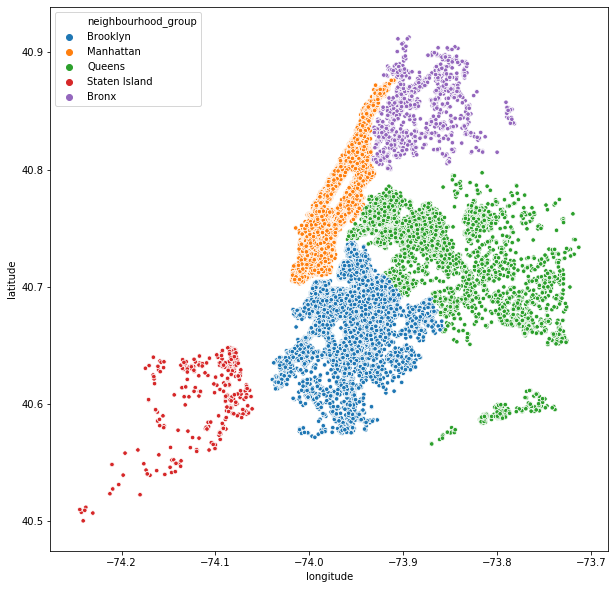

In [12]:
#Review the listings by boroname
plt.figure(figsize=(10,10))
sns.scatterplot(x='longitude', y='latitude', hue='neighbourhood_group',s=20, data=ny_airbnb)

In [13]:
from folium.plugins import HeatMap
m=folium.Map([-34.5899,-58.416363504830635],zoom_start=11)
HeatMap(ba_airbnb[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(m)
display(m)

The dataset of Buenos Aires doesn't have the column *neighbourhood_group*. So it has a lot of neighbourhood.  
For the visualisation, we will remove all neighbourhoods which have less than 1000 airbnbs.

In [14]:
print('Before removing Neighbourhood under 1000 values :', 
      len(ba_airbnb['neighbourhood'].unique()),
      ' neighbourhoods\n',
      ba_airbnb['neighbourhood'].value_counts()
     )

counts = ba_airbnb['neighbourhood'].value_counts()
ba_airbnb=ba_airbnb[ba_airbnb['neighbourhood'].isin(counts.index[counts > 1000])]

print('After removing Neighbourhood under 1000 values :', 
      len(ba_airbnb['neighbourhood'].unique()),
      'neighbourhoods\n',
      ba_airbnb['neighbourhood'].value_counts(),
      '\nNumber of values in the dataset:',
      ba_airbnb['neighbourhood'].count()
     )


Before removing Neighbourhood under 1000 values : 48  neighbourhoods
 Palermo              6934
Recoleta             3687
San Nicolas          1316
Retiro               1159
Balvanera            1100
Belgrano             1048
Almagro               979
Monserrat             953
Villa Crespo          770
San Telmo             692
Colegiales            462
Caballito             459
Chacarita             426
Nuñez                 424
Constitucion          335
Villa Urquiza         249
Puerto Madero         243
Barracas              173
Saavedra              149
San Cristobal         148
Boca                  119
Boedo                 113
Flores                113
Coghlan                93
Villa Ortuzar          90
Villa Devoto           73
Parque Patricios       66
Villa Del Parque       54
Parque Chas            52
Parque Chacabuco       47
Villa Pueyrredon       42
Floresta               40
Villa Gral. Mitre      37
Agronomia              36
Paternal               31
Monte Castro        

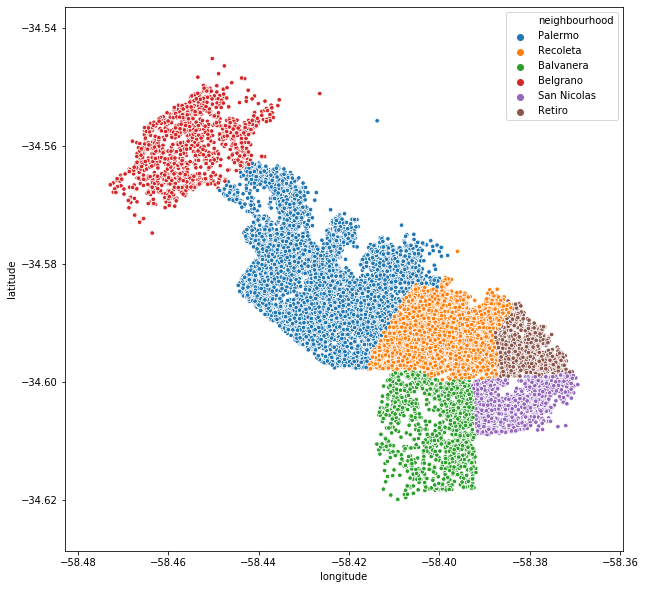

In [15]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='longitude', y='latitude', hue='neighbourhood',s=20, data=ba_airbnb)

In [16]:
fig = make_subplots(
    rows=1, cols=2,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{'type':'domain'},
            {'type':'domain'}]]
)


roomba_airbnb = ba_airbnb.groupby('neighbourhood').size()/ba_airbnb['neighbourhood'].count()*100
labels = roomba_airbnb.index
values = roomba_airbnb.values
fig_ba = go.Pie(labels=labels, values=values, hole=.5, name="Buenos Air")

roomny_airbnb = ny_airbnb.groupby('neighbourhood_group').size()/ny_airbnb['neighbourhood_group'].count()*100
labels = roomny_airbnb.index
values = roomny_airbnb.values
fig_ny = go.Pie(labels=labels, values=values, hole=.5, name="New York")

fig.add_trace(fig_ba, row=1, col=1)
fig.add_trace(fig_ny, row=1, col=2)

fig.update_layout(
    title_text="Repartition of room type in New York and Buenos Air",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Buenos Air', x=0.15, y=0.5, font_size=20, showarrow=False),
                 dict(text='New York', x=0.84, y=0.5, font_size=20, showarrow=False)])

fig.show()

So it's seems like in NY, I will have only the choice of two neighbourhoods : **Manhattan** and **Brooklyn**.   
In BA, I have more choices, but if I want to be close to the sea, the geolocalisation shows that **Palermo** would be the best neighbourhood.

Now, we'll look at neighbourhoods, we'll look at the price per neighbourhood to make our decisions. 

In [17]:
fig = make_subplots(
    rows=1, cols=2,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{'type':'domain'},
            {'type':'domain'}]]
)


roomba_airbnb = ba_airbnb.groupby('price_cat').size()/ba_airbnb['price_cat'].count()*100
labels = roomba_airbnb.index
values = roomba_airbnb.values
fig_ba = go.Pie(labels=labels, values=values, hole=.5, name="Buenos Aires", sort=False)

roomny_airbnb = ny_airbnb.groupby('price_cat').size()/ny_airbnb['price_cat'].count()*100
labels = roomny_airbnb.index
values = roomny_airbnb.values
fig_ny = go.Pie(labels=labels, values=values, hole=.5, name="New York", sort=False)

fig.add_trace(fig_ba, row=1, col=1)
fig.add_trace(fig_ny, row=1, col=2)

fig.update_layout(
    title_text="Repartition of price in New York and Buenos Aires",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Buenos Aires', x=0.13, y=0.5, font_size=20, showarrow=False),
                 dict(text='New York', x=0.84, y=0.5, font_size=20, showarrow=False)])

fig.show()

In [18]:
ng = ba_airbnb[ba_airbnb.price <250]

fig = px.box(ng, x="neighbourhood", y="price", color="neighbourhood")
fig.update_layout(title_text="Distribution of Neighbourhood price under 250 in Buenos Air")

fig.show()

In [19]:
ng = ny_airbnb[ny_airbnb.price <250]

fig = px.box(ng, x="neighbourhood_group", y="price", color="neighbourhood_group")
fig.update_layout(title_text="Distribution of Neighbourhood price under 250 in New York")

fig.show()

As we can expect, New York is way more expensive than Buenos Aires. But let's face it, with the actual situation *(COVID-19)* it's a bit difficult to go anywhere.

But don't let us be demoralized and keep looking for our perfect destination.   
So now, we'll looking for what kind of locations we'll make. 

In [20]:
fig = make_subplots(
    rows=1, cols=2,
    shared_xaxes=True,
    vertical_spacing=0.03,
    specs=[[{'type':'domain'},
            {'type':'domain'}]]
)


roomba_airbnb = ba_airbnb.groupby('room_type').size()/ba_airbnb['room_type'].count()*100
labels = roomba_airbnb.index
values = roomba_airbnb.values
fig_ba = go.Pie(labels=labels, values=values, hole=.5, name="Buenos Aires")

roomny_airbnb = ny_airbnb.groupby('room_type').size()/ny_airbnb['room_type'].count()*100
labels = roomny_airbnb.index
values = roomny_airbnb.values
fig_ny = go.Pie(labels=labels, values=values, hole=.5, name="New York")

fig.add_trace(fig_ba, row=1, col=1)
fig.add_trace(fig_ny, row=1, col=2)

fig.update_layout(
    title_text="Repartition of room type in New York and Buenos Aires",
    annotations=[dict(text='Buenos Aires', x=0.13, y=0.5, font_size=20, showarrow=False),
                 dict(text='New York', x=0.84, y=0.5, font_size=20, showarrow=False)])

fig.show()

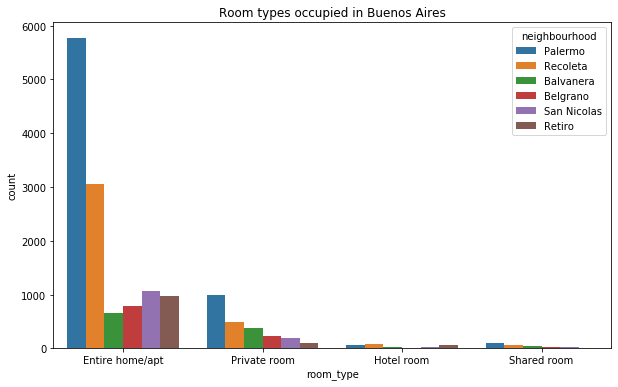

In [32]:
plt.figure(figsize=(10,6))
sns.countplot(x = 'room_type',hue = "neighbourhood",data = ba_airbnb)
plt.title("Room types occupied range by neighbourhood in Buenos Aires")
plt.show()

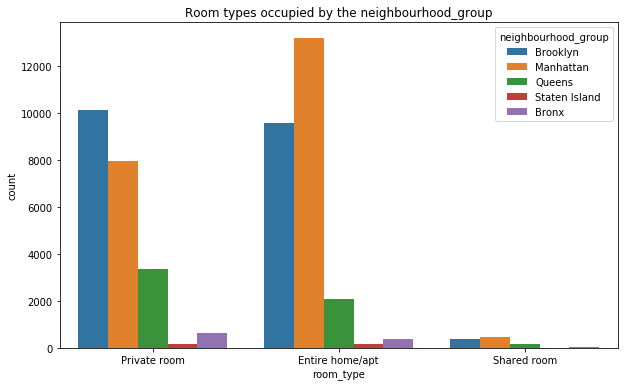

In [22]:
plt.figure(figsize=(10,6))
sns.countplot(x = 'room_type',hue = "neighbourhood_group",data = ny_airbnb)
plt.title("Room types occupied range by neighbourhood in New York")
plt.show()

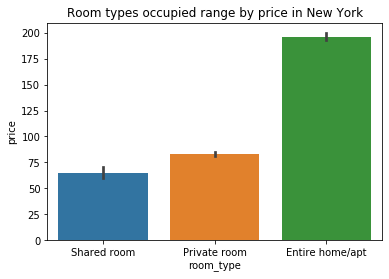

In [33]:
#room_type - price
result = ny_airbnb.groupby(["room_type"])['price'].aggregate(np.median).reset_index().sort_values('price')
sns.barplot(x='room_type', y="price", data=ny_airbnb, order=result['room_type'])
plt.title("Room types occupied range by price in New York")
plt.show()

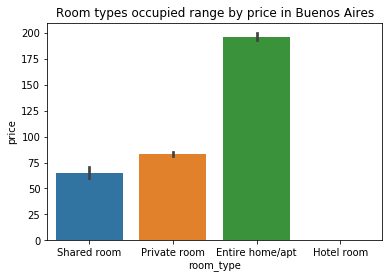

In [34]:
#room_type - price
result = ba_airbnb.groupby(["room_type"])['price'].aggregate(np.median).reset_index().sort_values('price')
sns.barplot(x='room_type', y="price", data=ny_airbnb, order=result['room_type'])
plt.title("Room types occupied range by price in Buenos Aires")
plt.show()

So as we see, the majority of locations are **Entire home/apt** and we also can choose **Private room**.   
The price is also variated. An etire home is way more expensive than a private since you have less space. So it's quite normal.

Now it just depends on what we want for our vacations, if we want to spent our week with a native or just with some friends.

Let's see the repartition of price with the localisation.

In [25]:
labels_ba = ['1. Between 0 and 25€', 
          '2. Between 25 and 50€', 
          '3. Between 50 and 100€',
          '4. Between 100 and 150€', 
          '5. Between 150 and 200€', 
          '6. Between 200 and 250€',
          '7. Between 250 and 300€', 
          '8. Between 300 and 500€',
          '9. Between 500 and '+ str(int(max(ba_airbnb['price']))) + '€']

fig = px.scatter_mapbox(ba_airbnb, lat=ba_airbnb['latitude'], 
                        lon=ba_airbnb['longitude'], hover_name="price_cat",
                        color_continuous_scale=px.colors.cyclical.IceFire,
                        color='price_cat',
                        zoom=11, height=300, size_max=15, category_orders={'price_cat': labels_ba})
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [26]:
labels_ny = ['1. Between 0 and 25€', 
          '2. Between 25 and 50€', 
          '3. Between 50 and 100€',
          '4. Between 100 and 150€', 
          '5. Between 150 and 200€', 
          '6. Between 200 and 250€',
          '7. Between 250 and 300€', 
          '8. Between 300 and 500€',
          '9. Between 500 and '+ str(int(max(ny_airbnb['price']))) + '€']

fig = px.scatter_mapbox(ny_airbnb, lat=ny_airbnb['latitude'], 
                        lon=ny_airbnb['longitude'], hover_name="price_cat",
                        color_continuous_scale=px.colors.cyclical.IceFire,
                        color='price_cat',zoom=8, height=300, category_orders={'price_cat': labels_ny})
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

So, it's not quite readable, I will try to make this more readable with a gif. 

### Reparition of price by neighbourhood

In [46]:
list_of_color = [['blue'], 
                 ['red'],
                 ['green'],
                 ['purple'], 
                 ['orange'],
                 ['darkblue'],
                 ['darkmagenta'],
                 ['darkgreen'],
                 ['magenta'],
                 ]

In [47]:
price_cat = list(set(ny_airbnb['price_cat']))
price_cat.sort()

for index, val in enumerate(price_cat):
    temp_df = ny_airbnb[ny_airbnb['price_cat'] == val]
    fig = px.scatter_mapbox(temp_df, 
                            lat=temp_df['latitude'],
                            lon=temp_df['longitude'], 
                            hover_name="price_cat",
                            color_discrete_sequence=list_of_color[index],
                            color='price_cat',
                            zoom=9, 
                            height=300, 
                            size_max=15)
    
    fig.update_layout(mapbox_style="open-street-map")
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.write_image("./price_ny/"+val+".png")

In [48]:
price_cat = list(set(ba_airbnb['price_cat']))
price_cat.sort()

for index,val in enumerate(price_cat):
    temp_df = ba_airbnb[ba_airbnb['price_cat'] == val]
    fig = px.scatter_mapbox(temp_df, 
                            lat=temp_df['latitude'], 
                            lon=temp_df['longitude'], 
                            hover_name="price_cat",
                            color_discrete_sequence=list_of_color[index],
                            color='price_cat',
                            zoom=10, 
                            height=300, 
                            size_max=15)
    
    fig.update_layout(mapbox_style="open-street-map")
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.write_image("./price_ba/"+val+".png")

With theses frames, I create a gif using convert and the image saved directly in the terminal.

For New York :

```
> cd price_ny/
> convert -delay 100 -loop 0 "1. Between 0 and 25€.png" "2. Between 25 and 50€.png" "3. Between 50 and 100€.png" "4. Between 100 and 150€.png" "5. Between 150 and 200€.png" "6. Between 200 and 250€.png" "7. Between 250 and 300€.png" "8. Between 300 and 500€.png" "9. Between 500 and 9259€.png" cat_ny.gif
```

For Buenos Aires : 


```
> cd price_ba/
> convert -delay 100 -loop 0 "1. Between 0 and 25€.png" "2. Between 25 and 50€.png" "3. Between 50 and 100€.png" "4. Between 100 and 150€.png" "5. Between 150 and 200€.png" "6. Between 200 and 250€.png" "7. Between 250 and 300€.png" "8. Between 300 and 500€.png" "9. Between 500 and 9259€.png" cat_ba.gif
```

In [37]:
new_york_gif = Image.open('./price_ny/cat_ny.gif')
new_york_gif.show()

frame2 = PhotoImage(file=imagefilename, format="gif -index 2")

Now, we just want to see what could be the most used words in those two datasets.

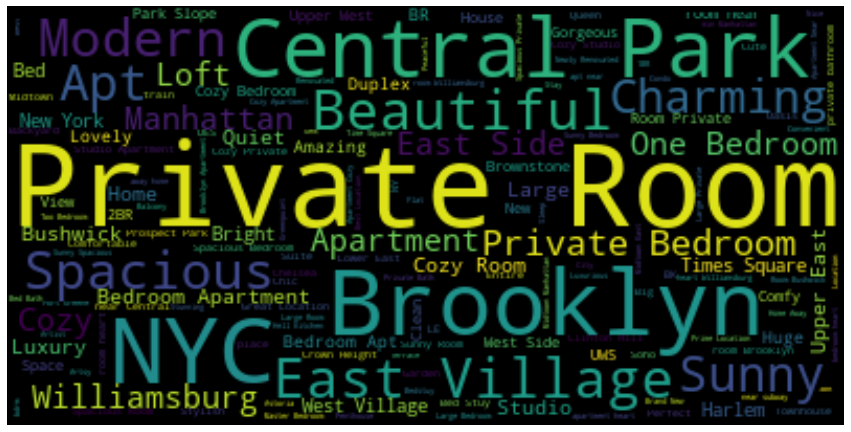

In [30]:
from wordcloud import WordCloud, ImageColorGenerator,STOPWORDS
text = " ".join(str(each) for each in ny_airbnb.name)

# Create and generate a word cloud image:

stopwords=set(STOPWORDS)

wordcloud = WordCloud(max_words=200,
                      background_color="black",
                      max_font_size=92,
                      contour_width=3,
                      contour_color='steelblue',
                      stopwords=stopwords)
wordcloud.generate(text)
#plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

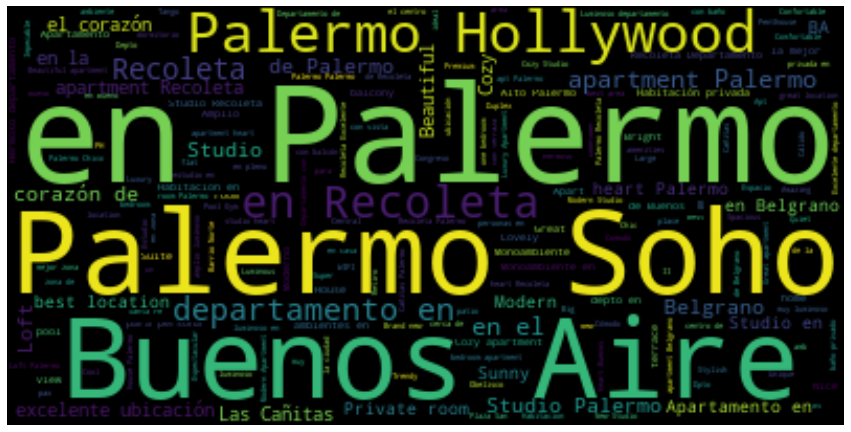

In [31]:
text = " ".join(str(each) for each in ba_airbnb.name)

# Create and generate a word cloud image:

stopwords=set(STOPWORDS)

wordcloud = WordCloud(max_words=200,
                      background_color="black",
                      max_font_size=92,
                      contour_width=3,
                      contour_color='steelblue',
                      stopwords=stopwords)
wordcloud.generate(text)
#plt.figure(figsize=(10,6))
plt.figure(figsize=(15,10))

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()